In [58]:
from ucimlrepo import fetch_ucirepo

# fetch dataset
breast_cancer_wisconsin_original = fetch_ucirepo(id=15)

# data (as pandas dataframes)
X = breast_cancer_wisconsin_original.data.features
y = breast_cancer_wisconsin_original.data.targets
# write data to new file
X.to_csv('X.csv', index=False)
y.to_csv('y.csv', index=False)


# # metadata
metadata_str = str(breast_cancer_wisconsin_original.metadata)

# # write meta data to new file
with open('metadata.txt', 'w') as f:
    f.write(metadata_str)

# # variable information
print(breast_cancer_wisconsin_original.variables)
with open('variables.txt', 'w') as f:
    f.write(str(breast_cancer_wisconsin_original.variables))

                           name     role         type demographic  \
0            Sample_code_number       ID  Categorical        None   
1               Clump_thickness  Feature      Integer        None   
2       Uniformity_of_cell_size  Feature      Integer        None   
3      Uniformity_of_cell_shape  Feature      Integer        None   
4             Marginal_adhesion  Feature      Integer        None   
5   Single_epithelial_cell_size  Feature      Integer        None   
6                   Bare_nuclei  Feature      Integer        None   
7               Bland_chromatin  Feature      Integer        None   
8               Normal_nucleoli  Feature      Integer        None   
9                       Mitoses  Feature      Integer        None   
10                        Class   Target       Binary        None   

                  description units missing_values  
0                        None  None             no  
1                        None  None             no  
2           

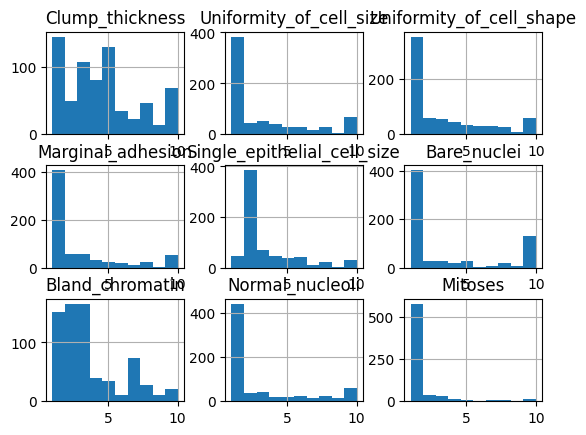

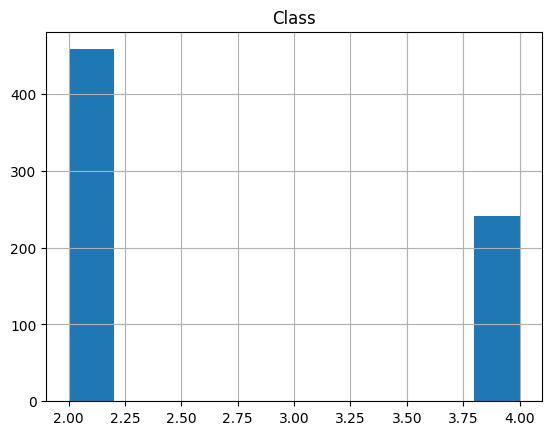

In [59]:
# plot histogram of x
import matplotlib.pyplot as plt
X.hist()
y.hist()
plt.show()


In [60]:
# check missing values
missing_values = X.isnull().sum()
print(missing_values)

missing_result = y.isnull().sum()
print(missing_result)
# Preprocess data (replace missing values with mode)
X_preprocessed = X.apply(lambda col: col.fillna(col.mode()[0]))

# Save preprocessed data to new files
# include y to the preprocessed data
X_preprocessed.to_csv('X_preprocessed.csv', index=False)
# Check missing values after preprocessing
missing_values_after = X_preprocessed.isnull().sum()
print("\nMissing Values After Preprocessing:")
print(missing_values_after)

# split data into train and test set
from sklearn.model_selection import train_test_split
X_train, X_test , y_train , y_test= train_test_split(X_preprocessed,y, test_size=0.2, random_state=42)
# write to new files
X_train.to_csv('X_train.csv', index=False)
X_test.to_csv('X_test.csv', index=False)
y_train.to_csv('y_train.csv', index=False)
y_test.to_csv('y_test.csv', index=False)

X_preprocessed['y'] = y
X_preprocessed.to_csv('data.csv', index=False)

Clump_thickness                 0
Uniformity_of_cell_size         0
Uniformity_of_cell_shape        0
Marginal_adhesion               0
Single_epithelial_cell_size     0
Bare_nuclei                    16
Bland_chromatin                 0
Normal_nucleoli                 0
Mitoses                         0
dtype: int64
Class    0
dtype: int64

Missing Values After Preprocessing:
Clump_thickness                0
Uniformity_of_cell_size        0
Uniformity_of_cell_shape       0
Marginal_adhesion              0
Single_epithelial_cell_size    0
Bare_nuclei                    0
Bland_chromatin                0
Normal_nucleoli                0
Mitoses                        0
dtype: int64


In [61]:
# define the function 
import numpy as np
import math
def sigmoid(v):
    """
    This is sigmoid function
    """
    s=1/(1+math.exp(-v))
    return(s)

def Nout(x,w):
    """
    Sum of input,bias * weight(i)
    x=numpy.array() array of inputs and bias
    w=numpy.array() array of input weights and bias weight
    """
    o=sum(np.multiply(x,w))
    return(o)

def gradOut(e,y):
    """gradient of output node
    diff activation fuction is sigmoid
    y*(1-y)
        e is error of the node
    y is the output of the node
    
    """
    g=e*y*(1-y)
    return (g)

def gradH(y,summation):
    """gradient of hidden node
    diff activation fuction is sigmoid
    y*(1-y)
    y is the output of the node
    summation is sum of previous nodes* weight"""
    g=y*(1-y)*summation
    return (g)


def deltaw(l,g,x):
    """Calculate the delta weight
    l is learning rate
    g is gradient of the node
    x is input of the node"""
    x_array=np.array(x)
    d=-l*g*x_array
    return(d)

In [62]:

# read file from X_train.csv and onvert to array
import pandas as pd
import numpy as np
df=pd.read_csv('x_train.csv')
training_data = np.array(df)
# Get the number of rows in your array
print(training_data[1])
num_rows = training_data.shape[0]
print("row in training set = " ,num_rows)
# add bias to the input
bias=np.ones((num_rows,1)) 
training_data=np.append(training_data,bias,axis=1)
print(training_data[1])


[5. 3. 3. 4. 2. 4. 3. 4. 1.]
row in training set =  559
[5. 3. 3. 4. 2. 4. 3. 4. 1. 1.]


In [63]:
def forward_propagation(x,weight):
    """
    This function takes in the input and weight and returns the output of the output node
    x is the input of the node
    weight is the weight of the node
    """
    summation=Nout(x,weight)
    y=sigmoid(summation)
    # print(f"\nSum(V) of node is: %8.3f, Y from node is: %8.3f" % (summation, y))
    return y

def backward_propagation(x,weight, grad,learning_rate):
    """
    This function takes in the input, weight, output of the node, error of the node and learning rate
    and returns the updated weight
    x is the input of the node
    weight is the weight of the node
    grad is the gradient of the node
    learning_rate is the learning rate
    """
    d=deltaw(learning_rate,grad,x)
    weight=weight+d
    return(weight)

In [64]:
def approxiamate(data , w1 , w2 , w3 , w4 ,w5 ,learning_rate , design_output):
    """
    This function takes in the input data, weight, learning rate and design output
    and returns the updated weight
    data is the input of the node
    w is the weight of the node
    learning_rate is the learning rate
    """
    y1 = forward_propagation(data,w1)
    y2 = forward_propagation(data,w2)
    y3 = forward_propagation(data,w3)
    output_hidden = [y1,y2,y3 ,1]
    y4 = forward_propagation(output_hidden,w4)
    y5 = forward_propagation(output_hidden,w5)
    
    # error of output node
    e4 = design_output - y4
    e5 = design_output - y5
    
    err = (e4 + e5) / 2
    
    if err != 0:
        print(f"\nError of output node is: %8.3f" % (err))
        grad4 = gradOut(e4,y4)
        grad5 = gradOut(e5,y5)
        print(f"\nGradient of output node 4 is: %8.3f, Gradient of output node 5 is: %8.3f" % (grad4, grad5))
        w4 = backward_propagation(output_hidden,w4,grad4,learning_rate)
        w5 = backward_propagation(output_hidden,w5,grad5,learning_rate)
        print(f"\nUpdated weight of output node 4 are: {w4}")
        print(f"\nUpdated weight of output node 5 is: {w5}")
        
        grad3 = gradH(y3,((w4[2] * grad4 )+ (w5[2] * grad5)))
        grad2 = gradH(y2,((w4[1] * grad4 )+ (w5[1] * grad5)))
        grad1 = gradH(y1,((w4[0] * grad4 )+ (w5[0] * grad5)))
        print(f"\nGradient of hidden node 3 is: %8.3f, Gradient of hidden node 2 is: %8.3f, Gradient of hidden node 1 is: %8.3f" % (grad3, grad2, grad1))
        w3 = backward_propagation(data,w3,grad3,learning_rate)
        w2 = backward_propagation(data,w2,grad2,learning_rate)
        w1 = backward_propagation(data,w1,grad1,learning_rate)
        print(f"\nUpdated weight of hidden node 3 are: %8.3f{w3}")
        print(f"\nUpdated weight of hidden node 2 are: %8.3f{w2}")
        print(f"\nUpdated weight of hidden node 1 are: %8.3f {w1}")
    
    return err , w1 , w2 , w3 , w4 ,w5
            
        
    

In [86]:
def train(data_set, result_set ,cycles ,weight1N , weight2N , weight3N , weight4N , weight5N , learning_rate):
    
    avg_err = 0
    design_output = 7
    for i in range(cycles):
        print("\n Cycle " , i+1)
        for j in range(len(data_set)):
            # check if the class is 2 design output is 0 else 1
            if result_set[j] == 2:
                design_output = 0
            elif result_set[j] == 4:
                design_output = 1
            # print("Design out" ,design_output)            
            
            err , weight1N , weight2N , weight3N , weight4N , weight5N = approxiamate(data_set[j] , weight1N , weight2N , weight3N , weight4N , weight5N , learning_rate , design_output)
            avg_err += err
       
    avg_err /= len(data_set)
    print(f"\nAverage error of the cycle is: %8.3f" % (avg_err))
    print(f"\nUpdated weight of hidden node 1 are: {weight1N}")
    print(f"\nUpdated weight of hidden node 2 are: {weight2N}")
    print(f"\nUpdated weight of hidden node 3 are: {weight3N}")
    print(f"\nUpdated weight of output node 4 are: {weight4N}")
    print(f"\nUpdated weight of output node 5 are: {weight5N}")
    return weight1N , weight2N , weight3N , weight4N , weight5N , avg_err
        
    

In [66]:
def test(data_set ,result_set, w1 , w2 , w3 , w4 ,w5, avg_err):
    
    total = 0
    correct = 0
    for j in range(len(data_set)):
        correct_ans = result_set[j]
        y1 = forward_propagation(data_set[j],w1)
        y2 = forward_propagation(data_set[j],w2)
        y3 = forward_propagation(data_set[j],w3)
        output_hidden = [y1,y2,y3 ,1]
        y4 = forward_propagation(output_hidden,w4)
        y5 = forward_propagation(output_hidden,w5)
        total += 1
        r1 = 1 if y4 >= 0.5 else 0
        r2 = 1 if y5 >= 0.5 else 0
        result = [r1,r2]
        if result == [0 ,0]:
            result = 2
        else:
            result = 4
            
        if result == correct_ans:   
            correct += 1
    accuracy = (correct / total) * 100
    print(f"\nAccuracy of the model is: %8.3f" % (accuracy))
    print(f"\nAverage error of the model is: %8.3f" % (avg_err))
    
    return accuracy
    

In [67]:
import random as rd

# random weight from -1 to 1 the last in array is bias
weight = np.array([rd.uniform(-1,1) for i in range(10)])
# print(weight)
def randomWeight():
    weight1N = np.array([rd.uniform(-1, 1) for i in range(10)])
    weight2N = np.array([rd.uniform(-1, 1) for i in range(10)])
    weight3N = np.array([rd.uniform(-1, 1) for i in range(10)])
    weight4N = np.array([rd.uniform(-1, 1) for i in range(4)])
    weight5N = np.array([rd.uniform(-1, 1) for i in range(4)])

    # Use a loop to print each weight array separately
    print("\nWeight1N:", end=" ")
    print(", ".join("%8.3f" % val for val in weight1N))

    print("Weight2N:", end=" ")
    print(", ".join("%8.3f" % val for val in weight2N))

    print("Weight3N:", end=" ")
    print(", ".join("%8.3f" % val for val in weight3N))

    print("Weight4N:", end=" ")
    print(", ".join("%8.3f" % val for val in weight4N))

    print("Weight5N:", end=" ")
    print(", ".join("%8.3f" % val for val in weight5N))

    return weight1N, weight2N, weight3N, weight4N, weight5N


In [83]:
# train the model
cycles = 1
learning_rate = -0.5
weight1N , weight2N , weight3N , weight4N , weight5N = randomWeight()
training_data = np.array(pd.read_csv('X_train.csv'))
print(training_data[1])
# append bias to the training data
bias = np.ones((training_data.shape[0],1))
training_data = np.append(training_data,bias,axis=1)
result_training = np.array(pd.read_csv('y_train.csv'))
print(training_data[1])
print(result_training[1])

w1 , w2 , w3 , w4 ,w5 , avg_err = train(training_data ,result_training, cycles , weight1N , weight2N , weight3N , weight4N , weight5N, learning_rate)

# test model
test_data = np.array(pd.read_csv('X_test.csv'))
bias = np.ones((test_data.shape[0],1))
test_data = np.append(test_data,bias,axis=1)
result_test = np.array(pd.read_csv('y_test.csv'))
accuracy = test( test_data, result_test,w1 , w2 , w3 , w4 ,w5 , avg_err)




Weight1N:    0.965,    0.963,    0.706,    0.776,    0.363,    0.777,   -0.737,   -0.083,   -0.115,    0.431
Weight2N:    0.974,    0.297,   -0.961,   -0.585,    0.143,    0.180,   -0.145,    0.148,   -0.225,   -0.589
Weight3N:   -0.967,    0.966,    0.957,   -0.518,   -0.453,   -0.274,   -0.338,   -0.739,    0.885,   -0.784
Weight4N:   -0.456,    0.473,   -0.991,   -0.852
Weight5N:   -0.004,    0.758,   -0.312,   -0.299
[5. 3. 3. 4. 2. 4. 3. 4. 1.]
[5. 3. 3. 4. 2. 4. 3. 4. 1. 1.]
[4]

Error of output node is:   -0.452

Gradient of output node 4 is:   -0.062, Gradient of output node 5 is:   -0.145

Updated weight of output node 4 are: [-0.48711321  0.44338152 -0.9912575  -0.88345675]

Updated weight of output node 5 is: [-0.07614544  0.68835169 -0.31193319 -0.37081995]

Gradient of hidden node 3 is:    0.001, Gradient of hidden node 2 is:   -0.004, Gradient of hidden node 1 is:    0.000

Updated weight of hidden node 3 are: %8.3f[-0.96561826  0.96613717  0.9572068  -0.51815859 -0.4527

In [ ]:

weight1N_values = [-0.344, -0.368, -0.459, 0.283, -0.741, 0.509, 0.743, -0.880, -0.384, 0.519]
weight2N_values = [-0.883, 0.727, 0.457, -0.491, -0.037, 0.703, 0.321, -0.336, 0.436, 0.714]
weight3N_values = [-0.355, 0.269, -0.472, 0.398, -0.446, -0.521, -0.686, 0.294, 0.262, 0.523]
weight4N_values = [0.780, 0.499, 0.233, -0.841]
weight5N_values = [0.929, -0.400, -0.135, -0.033]

# Convert to NumPy arrays
weight1N = np.array(weight1N_values)
weight2N = np.array(weight2N_values)
weight3N = np.array(weight3N_values)
weight4N = np.array(weight4N_values)
weight5N = np.array(weight5N_values)


# train the model
cycles = 1
learning_rate = -0.5
training_data = np.array(pd.read_csv('X_train.csv'))
# append bias to the training data
bias = np.ones((training_data.shape[0],1))
training_data = np.append(training_data,bias,axis=1)
result_training = np.array(pd.read_csv('y_train.csv'))
w1 , w2 , w3 , w4 ,w5 , avg_err = train(training_data ,result_training, cycles , weight1N , weight2N , weight3N , weight4N , weight5N, learning_rate)

# test model
test_data = np.array(pd.read_csv('X_test.csv'))
bias = np.ones((test_data.shape[0],1))
test_data = np.append(test_data,bias,axis=1)
result_test = np.array(pd.read_csv('y_test.csv'))
accuracy = test( test_data, result_test,w1 , w2 , w3 , w4 ,w5 , avg_err)


 Cycle  1

Error of output node is:   -0.420

Gradient of output node 4 is:   -0.083, Gradient of output node 5 is:   -0.120

Updated weight of output node 4 are: [ 0.77555311  0.48417886  0.2320009  -0.88253157]

Updated weight of output node 5 is: [ 0.92258407 -0.42138382 -0.1364415  -0.09292143]

Gradient of hidden node 3 is:   -0.000, Gradient of hidden node 2 is:    0.002, Gradient of hidden node 1 is:   -0.017

Updated weight of hidden node 3 are: %8.3f[-0.35517134  0.26893146 -0.47203427  0.39796573 -0.44606854 -0.52103427
 -0.6861028   0.29396573  0.26196573  0.52296573]

Updated weight of hidden node 2 are: %8.3f[-0.87710015  0.72935994  0.45817997 -0.48982003 -0.03464006  0.70417997
  0.32453991 -0.33482003  0.43717997  0.71517997]

Updated weight of hidden node 1 are: %8.3f [-0.38582488 -0.38472995 -0.46736498  0.27463502 -0.75772995  0.50063502
  0.71790507 -0.88836498 -0.39236498  0.51063502]

Error of output node is:    0.611

Gradient of output node 4 is:    0.147, Grad

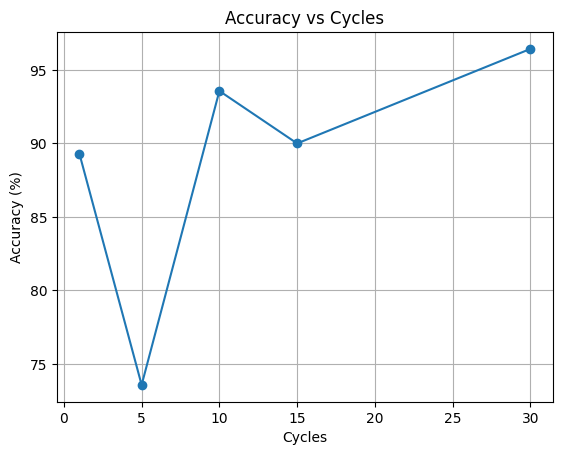

In [89]:
import matplotlib.pyplot as plt

def plot_accuracy_vs_cycles(cycle_values, accuracies):
    plt.plot(cycle_values, accuracies, marker='o')
    plt.xlabel('Cycles')
    plt.ylabel('Accuracy (%)')
    plt.title('Accuracy vs Cycles')
    plt.grid(True)
    plt.show()

def train_and_test_with_cycles(cycle_values, weight1N, weight2N, weight3N, weight4N, weight5N, learning_rate):
    accuracies = []

    for cycles in cycle_values:
        # train the model
        w1, w2, w3, w4, w5, avg_err = train(training_data, result_training, cycles, weight1N, weight2N, weight3N, weight4N, weight5N, learning_rate)

        # test the model
        accuracy = test(test_data, result_test, w1, w2, w3, w4, w5, avg_err)
        accuracies.append(accuracy)

    return accuracies

# Initial weights
weight1N_values = [-0.344, -0.368, -0.459, 0.283, -0.741, 0.509, 0.743, -0.880, -0.384, 0.519]
weight2N_values = [-0.883, 0.727, 0.457, -0.491, -0.037, 0.703, 0.321, -0.336, 0.436, 0.714]
weight3N_values = [-0.355, 0.269, -0.472, 0.398, -0.446, -0.521, -0.686, 0.294, 0.262, 0.523]
weight4N_values = [0.780, 0.499, 0.233, -0.841]
weight5N_values = [0.929, -0.400, -0.135, -0.033]

weight1N = np.array(weight1N_values)
weight2N = np.array(weight2N_values)
weight3N = np.array(weight3N_values)
weight4N = np.array(weight4N_values)
weight5N = np.array(weight5N_values)

# Load training and testing data
training_data = np.array(pd.read_csv('X_train.csv'))
bias_training = np.ones((training_data.shape[0], 1))
training_data = np.append(training_data, bias_training, axis=1)
result_training = np.array(pd.read_csv('y_train.csv'))

test_data = np.array(pd.read_csv('X_test.csv'))
bias_test = np.ones((test_data.shape[0], 1))
test_data = np.append(test_data, bias_test, axis=1)
result_test = np.array(pd.read_csv('y_test.csv'))

# Set cycle values
cycle_values = [1, 5, 10, 15, 30]

# Set learning rate
learning_rate = -0.5

# Train and test with different cycle values
accuracies = train_and_test_with_cycles(cycle_values, weight1N, weight2N, weight3N, weight4N, weight5N, learning_rate)
# print accuracy with two decimal places
accuracies = [round(accuracy, 2) for accuracy in accuracies]
print(accuracies)
# Plot the graph
plot_accuracy_vs_cycles(cycle_values, accuracies)
